<a href="https://colab.research.google.com/github/Jass6767/transcriber/blob/main/transcribe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
print("hello world")

hello world


In [ ]:
import numpy as np
from IPython.display import Audio
from google.colab import files

In [ ]:
uploaded = files.upload()

Saving transcribing_1.mp3 to transcribing_1 (2).mp3


In [ ]:
fileName = list(uploaded.keys())[0]
Audio(fileName)

In [ ]:
import librosa
import scipy
import soundfile
import matplotlib.pyplot as plt


In [ ]:
y, sr = librosa.load(fileName, sr=None)

In [ ]:
y, sr

(array([0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 5.9834829e-06,
        8.7567005e-06, 2.2340105e-06], dtype=float32),
 48000)

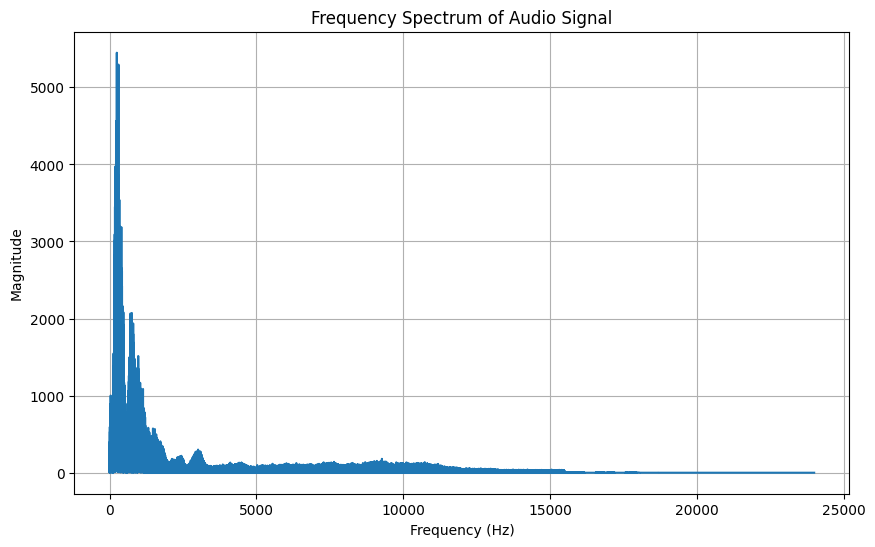

In [ ]:
n = len(y)
f = np.fft.fftfreq(n, 1/sr)
Y = np.fft.fft(y)

plt.figure(figsize=(10, 6))
plt.plot(f[:n//2], np.abs(Y[:n//2]))
plt.title("Frequency Spectrum of Audio Signal")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.grid(True)
plt.show()

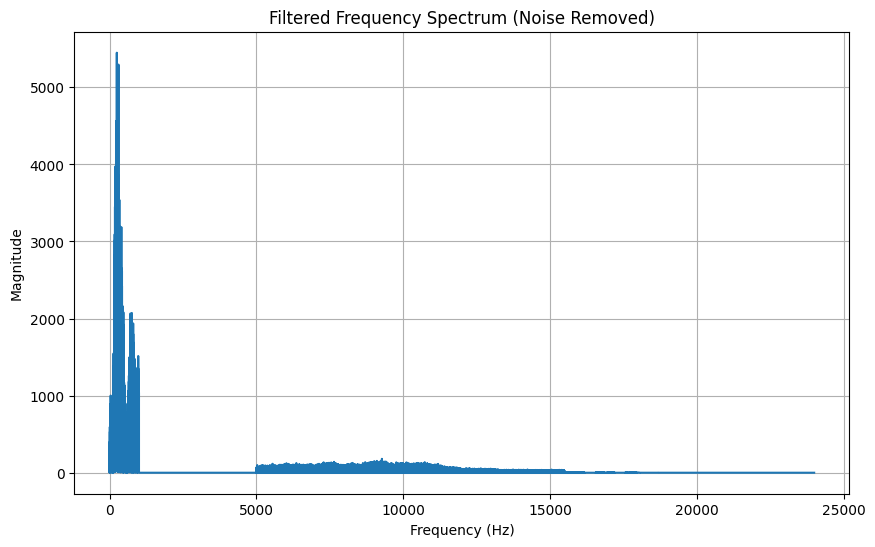

In [ ]:
# Zero out high-frequency noise (example: above 3000 Hz)
noise_range = (1000, 5000)  # Adjust this range based on your observations
Y_filtered = Y.copy()
Y_filtered[(f > noise_range[0]) & (f < noise_range[1])] = 0

# Plot the filtered frequency spectrum
plt.figure(figsize=(10, 6))
plt.plot(f[:n//2], np.abs(Y_filtered[:n//2]))  # Plot filtered frequencies
plt.title("Filtered Frequency Spectrum (Noise Removed)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.grid(True)
plt.show()


In [ ]:
y_filtered = np.fft.ifft(Y_filtered).real
y_filtered = y_filtered / np.max(np.abs(y_filtered))

import soundfile as sf
from IPython.display import Audio

# Save the cleaned audio
sf.write("cleaned_audio_fft.wav", y_filtered, sr)
Audio("cleaned_audio_fft.wav")
